# DTSA 5800 Network Analysis for Marketing Analytics Final Project

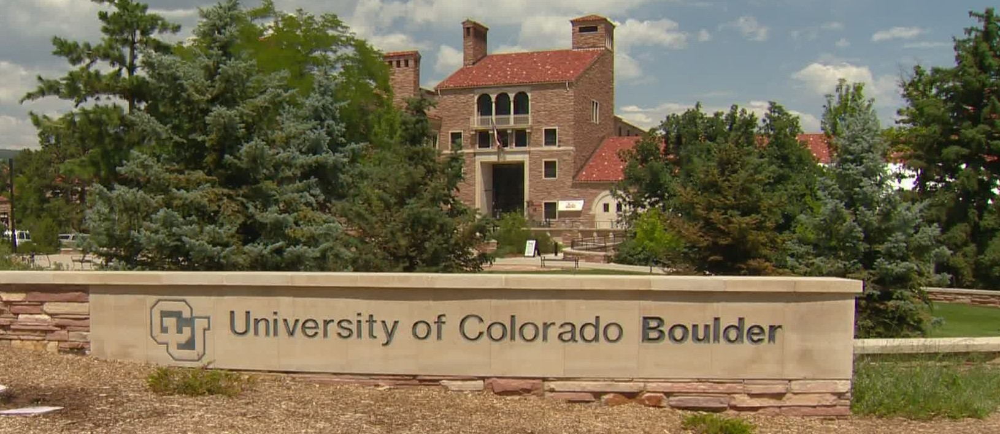

This notebook is my final project for DTSA 5800 Network Analysis for Marketing Analytics course.

As a base for the notebook I used the MSDSNetworkAnalysis_Lab02_SemanticNetwork notebook from week 4 of the course, because toppic is quite simliar.

In this project, I am going to do an analysis of how consumers talk about three competing brands: Nike, Adidas, and Lululemon. 

I do a network analysis of the tweets that are created that mention those brands. As you know, Twitter is an interesting place where people, bots and organizations all join the conversation. My goal for this project is to better understand the chatter around each brand, what makes each brand unique, and what makes each brand different. I also will use network analysis to identify users that are most central to our brand and ones that are hyper interested in our product category in general, here athletic wear.

##The Data

We used the Twitter API, specifically the Search Endpoint, to retrieve Tweets that mention the three brands. We retrieved data for the last 93 days. All in all, it’s about ~150k tweets. These tweets are “at Mentions” (@nike, @lululemon, @adidas). These tweets were sent from the US and are in English. Presumably, these mentions contain all kinds of conversations:

* Consumer / customer mentions, alerting Nike to a message, or tagging them in their experience
* Other brands who cross promote and their corporate messaging
* Affiliated companies, such as retail stores and their corporate messaging
* Probably random spam bots mentioning the brands
* God knows what else that lives on the far reaches of Twitter


The data is saved here:

http://128.138.93.164/nikelululemonadidas_tweets.jsonl.gz

It is in .jsonl format. We’ll go over how to parse it in our coding lectures.

##Twitter Mentions Graph

Using python you must create a valued, directed network graph of twitter mentions. Your graph will show Twitter users that are most centrally related to the brand (e.g., they regularly mention the brand). This graph will also illustrate who mentions who on Twitter, and in what way those mentions flow. You will create one mention graph, and that mention graph will have mentions for all three brands.

##Semantic Network Graph

Next, you'll create a semantic network analysis graph of words used in Tweets. Practically, this graph will reveal what words are most commonly associated with each other, for each brand. You will create one semantic graph, and that graph will have the data for all three brands.

##By follower count (influentials)

Segment the twitter data by follower count, that is, the number of followers a user has. Only look at tweets that originate from accounts that have lots of followers. These people are "influential" in that they have more of a following on the platform, and as a result, their opinions tend to matter more on the platform.

##Graph with Pyvis

Use Pyvis to create several visualizations of your networks using PyVis. When creating these visualizations, keep the following in mind:

* Is the graph comprehensible?
* How readable is it?
* Are there too many nodes? Less is more.
* Can you read the node labels?
* Are the clusters intuitive?
  * Those that try various clustering methods will shine here.
* Did you take screenshots (created images) that reflect several interesting, key clusters?

  * Don't be afraid to break up networks into multiple images (screenshots). That is, if there are several clusters of nodes (words/people) that you find particularly interesting, don't be afraid to turn each cluster into its own image.

## Mount Google Drive

In [153]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


##Scripts / Data Folder


All of your work and Twitter data should be saved in a folder called "Network Analysis" on your Google Drive. Name your final project submission notebook "1Final Report" Create a share link for the entire folder. Paste the URL in the submission for this assignment.

Here set path:

In [154]:
WORKING_DIR = "/content/drive/MyDrive/Network_Analysis"

##Imports

In [155]:
import gzip
import re
import itertools
import json
import networkx as nx
import matplotlib.pyplot as plt
import nltk
import string

# For visualization
try:
  from pyvis.network import Network as net
except:
  !pip install pyvis
  from pyvis.network import Network as net

## Get the data

In [156]:
DATA_FILE = "/content/drive/MyDrive/Network_Analysis/nikelululemonadidas_tweets.jsonl.gz"

### About the NLTK and NLP in Python

The [NLTK (Natural Language Toolkit)](https://www.nltk.org/) is an old standby for natural language processing (NLP) in the Python world.

There are a good number of NLP-related Python packages, but many of them are in fact built on the NLTK, so it is worth getting some foundational exposure to that package.

If you want to explore NLP with Python in more depth, popular libraries include [spaCy](https://spacy.io/) and [TextBlob](https://textblob.readthedocs.io/en/dev/) both of which are (like the NLTK) broadly scoped generalist NLP libraries.

There are also a good number of specialized libraries for a number of tasks, including keyword extraction, fuzzy string matching, natural language data handling, the list goes on. If you have a task at hand, it's worth doing a quick search to see if the problem has already been solved.

### NLTK downloads

A lot of NLTK tools fall into the category of corpus linguistics, and the algorithms for these tools often require large amounts of backing data that can unnecessarily bloat the package size if that tool is not being used.

To help manage bloat, the NLTK distributes its supplemental data via a download mechanism that is used on an as-needed basis.

For this assignment, you will be using the `punkt`, `stopwords` and `wordnet` datasets, which are downloaded here.

In [157]:
nltk.download("punkt")

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [158]:
nltk.download("stopwords")

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [159]:
nltk.download("wordnet")

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

## Text processing functions

Here, we define a few functions that will be used to clean up the tweet texts. Take the time to understand what these functions are doing and how they work. You may, however, want to skim ahead to get a sense of how these functions are being used in order to better motivate your understanding.

### Text tokenization




The near-universal preliminary step to natural language processing of free-form text content is the task of tokenization.

Tokenization is the task of breaking a text down into its component parts, which at the sentence level in English, we think of as words -- although tokens also include things like punctuation and sometimes special-case tokens creep in as we will see is the case for Tweets.

That's better. You will further work with the Tweet Tokenizer in Homework 1. Here, let's build a simple tokenize function that can use either the word tokenizer or the Tweet tokenizer.

While we are at it, we'll normalize the text to lowercase so that we can think of, e.g. "The" as being the same word as "the".

In [160]:
TWEET_TOKENIZER = nltk.TweetTokenizer().tokenize
WORD_TOKENIZER = nltk.tokenize.word_tokenize

def tokenize(text, lowercase=True, tweet=False):
    """Tokenize the text. By default, also normalizes text to lowercase.
    Optionally uses the Tweet Tokenizer.
    """
    if lowercase:
        text = text.lower()
    if tweet:
        return TWEET_TOKENIZER(text)
    else:
        return WORD_TOKENIZER(text)

### Functions that take tokens

After tokenizing, there are often a number of other preprocessing steps involved in preparing text data for analysis. We often consider mechanisms for text normalization.

We already lowercased the text for one kind of normalization. Another thing often considered are the ideas of stemming and lemmatization. These are both approaches to dealing with variations on word forms, such as pluralization, and conjugation.

Take a look at the following to get a feel for the differences. In this Lab, we will use the lemmatizer which uses more natural normalized word forms.

> ⚠️ **Caveat:** We will be using the lemmatizer in a bit of a naive way here. The WordNet lemmatizer defaults to treating words as nouns unless told otherwise. The result is that we are mainly just handling the differences in pluralization with the way we are lemmatizing. For more sophisticated lemmas, you would need to do part-of-speech tagging. You explored POS tagging in homework 2. Some extra work would be required to get the POS tags from that assignment into the form required by this lemmatizer. For purposes of this lab, we will stick with the default noun assumption.

> As an example of the effects of using POS tagging, see the code snippets below. [This article at machinelearningplus.com](https://www.machinelearningplus.com/nlp/lemmatization-examples-python/) provides a good overview of some different approaches to lemmatizing, including applying parts of speech to WordNet.

### Lemmatizing with POS

The following code snippets demonstrate differences in signaling the part-of-speech to the lemmatizer. The WordNet lemmatizer defaults to treating everything as nouns, which we will simply accept as good enough for the purpose of this lab.

In [161]:
STEMMER = nltk.PorterStemmer()

def stem(tokens):
    """Stem the tokens. I.e., remove morphological affixes and
    normalize to standardized stem forms.

    Has the side effective of producing "unnatural" forms due to
    stemming standards. E.g. quickly becomes quickli
    """
    return [ STEMMER.stem(token) for token in tokens ]

In [162]:
LEMMATIZER = nltk.WordNetLemmatizer()

def lemmatize(tokens):
    """Lemmatize the tokens.
    
    Retains more natural word forms than stemming, but assumes all
    tokens are nouns unless tokens are passed as (word, pos) tuples.
    """
    lemmas = []
    for token in tokens:
        if isinstance(token, str):
            lemmas.append(LEMMATIZER.lemmatize(token)) # treats token like a noun
        else: # assume a tuple of (word, pos)
            lemmas.append(LEMMATIZER.lemmatize(*token))
    return lemmas

### Removing stopwords

It can be useful to remove so-called stopwords to improve the average salience of the terms we are analyzing.

Stop words tend to be things like articles and conjunctions that usually don't offer a lot of value in an analysis.

The NLTK has a corpus of stopwords, but we'll include the option of passing in a custom list if desired.

In [163]:
def remove_stopwords(tokens, stopwords=None):
    """Remove stopwords, i.e. words that we don't want as part of our
    analysis. Defaults to the default set of nltk english stopwords.
    """
    if stopwords is None:
        stopwords = nltk.corpus.stopwords.words("english")
    return [ token for token in tokens if token not in stopwords ]

### Removing hyperlinks

Unless your analysis involves looking at what users are linking to (a more difficult and involved task than it might seem), then you might want to simply get those links out of the way.

In [164]:
def remove_links(tokens):
    """Removes http/s links from the tokens.

    This simple implementation assumes links have been kept intact as whole
    tokens. E.g. the way the Tweet Tokenizer works.
    """
    return [ t for t in tokens
            if not t.startswith("http://")
            and not t.startswith("https://")
        ]


### Removing punctuation

Finally, for our purposes of analysis, we are really only interested in words, not punctuation. Here, we simply remove tokens that are punctuation.

Tweets can get pretty messy, so we've gone beyond simply removing punctation tokens and decided to clean out punctuation altogether.

In [165]:
def remove_punctuation(tokens,
                       strip_mentions=False,
                       strip_hashtags=False,
                       strict=False):
    """Remove punctuation from a list of tokens.

    Has some specialized options for dealing with Tweets:

    strip_mentions=True will strip the @ off of @ mentions
    strip_hashtags=True will strip the # from hashtags

    strict=True will remove all punctuation from all tokens, not merely
    just tokens that are punctuation per se. 
    """
    tokens = [t for t in tokens if t not in string.punctuation]
    if strip_mentions:
        tokens = [t.lstrip('@') for t in tokens]
    if strip_hashtags:
        tokens = [t.lstrip('#') for t in tokens]
    if strict:
        cleaned = []
        for t in tokens:
            cleaned.append(
                t.translate(str.maketrans('', '', string.punctuation)).strip())
        tokens = [t for t in cleaned if t]
    return tokens

## Finally working with the data

Data cleanup is a big task and ultimately one of the bigger burdens of any analysis project. But, now that we have a good suite of utilities for handling our Tweets, the remainder of our work goes quickly.

The code below will do the following for each Tweet in the dataset:

 * Tokenize the text using the Tweet Tokenizer
 * Remove hyperlinks
 * Remove stopwords (standard English stopwords)
 * Remove punctuation tokens and strip @ and # from hashtags and mentions (see note below)
 * Lemmatize the remaining word tokens (using default noun part-of-speech for simplicity)

.. and will collect the unique words and their counts into `word_counts`.

> 💡 Since this is a semantic network we are building, it seems useful to, e.g., treat **@Nike** and **Nike** as the same word. Hence, `strip_mentions`, and `strip_hashtags`. In some cases, for example a mentions network, you would probably take a different approach. As you preprocess and prepare data for the task at hand, it is important to be intentional and aware of how you are handling the text with your end goals in mind.

First load tweets and create a nested dictonary with relvant data for further processing to process later on faster in memory.

In [166]:
tweets = {}
with gzip.open(DATA_FILE) as data_file:
    for i, line in enumerate(data_file):
        if i % 10000 == 0:
            print(f"Processed {i} tweets")
        tweet = json.loads(line)
        # ID of the Tweet            
       # tweets['id'] = tweet['id']
        # Create nested dictionary
        tweets[tweet['id']] = {}
        # Text of twveet
        tweets[tweet['id']]['full_text'] = tweet['full_text']
        # user_mentions
        tweets[tweet['id']]['user_mentions'] = tweet['entities']['user_mentions']
        # # of followers
        tweets[tweet['id']]['user_followers_count'] = tweet['user']['followers_count']
        # User ID
        tweets[tweet['id']]['user_id'] = tweet['user']['id']
        # User Name
        tweets[tweet['id']]['user_name'] = tweet['user']['name']

Processed 0 tweets
Processed 10000 tweets
Processed 20000 tweets
Processed 30000 tweets
Processed 40000 tweets
Processed 50000 tweets
Processed 60000 tweets
Processed 70000 tweets
Processed 80000 tweets
Processed 90000 tweets
Processed 100000 tweets
Processed 110000 tweets
Processed 120000 tweets
Processed 130000 tweets
Processed 140000 tweets
Processed 150000 tweets
Processed 160000 tweets
Processed 170000 tweets


#Questions to Answer

##Who are the Most Central Users?

In looking at your directed, valued network of mentions, what users are most central for each brand? Inspect at least the top 10 most central for each brand. Who are they? Why do you think they're so engaged with your brand on Twitter?

From an advertising/marketing perspective, these are our loyal brand ambassadors. A good social media manager should know who these people are and give them preferential treatment, such as sending them swag, sending them early access to new products/content, and generally engaging with them on the platform to show reciprocity in the relationship.

Create a directed graph of tweets and weight the edges with the number of followers a user has.

Every node will be a twitter user, and a edge is mentioned other users.

Size of the node represents the number of followers a user has.

I filtered the tweets down by a minumum number of followers a user has to have to be taken into account. In the example below the threshold was 100,000 followers.

Edges are coloured like the node they are comming from. If an edge is coming from a node with much followers it becomes bolder.

In [167]:
# create directed graph
users_g = net(height='1000px', width='100%', bgcolor='#222222', font_color='white', directed=True)

# Minimum number of followers to be taken into account
minimum_follower = 100000

# colour our brands different
# Nike
users_g.add_node(n_id = 415859364, title="Nike", label="Nike", size=50, color='#39a275')
# Adidas
users_g.add_node(n_id = 300114634, title="Adidas", label="Adidas", size=50, color='#194a8d')
# lululemon
users_g.add_node(n_id = 16252784, title="Lululemon", label="Lululemon", size=50, color='#df1c44')

i = 0
for tweet in tweets:
  i += 1
  if i % 10000 == 0:
      print(f"Processed {i} tweets")
  for mention in tweets[tweet]['user_mentions']:
    if tweets[tweet]['user_followers_count'] > minimum_follower:
      users_g.add_node(n_id = tweets[tweet]['user_id'], title=tweets[tweet]['user_name'], label=tweets[tweet]['user_name'], size=max(tweets[tweet]['user_followers_count']/minimum_follower, 1))
      users_g.add_node(n_id = mention['id'], title=mention['name'], label=mention['name'], size=1)
      users_g.add_edge(tweets[tweet]['user_id'], mention['id'], value=max(tweets[tweet]['user_followers_count']/minimum_follower, 1))

  

Processed 10000 tweets
Processed 20000 tweets
Processed 30000 tweets
Processed 40000 tweets
Processed 50000 tweets
Processed 60000 tweets
Processed 70000 tweets
Processed 80000 tweets
Processed 90000 tweets
Processed 100000 tweets
Processed 110000 tweets
Processed 120000 tweets
Processed 130000 tweets
Processed 140000 tweets
Processed 150000 tweets
Processed 160000 tweets
Processed 170000 tweets


In [168]:
users_g.save_graph('1_Most_Central_Users.html')

Herer some screenshots of full network and the surroundings of our brands interested in.

For interactive html with physics check out the shared google drive folder

### Full network

Red node is Lululemon

Blue node is Adidas

Green node is Nike

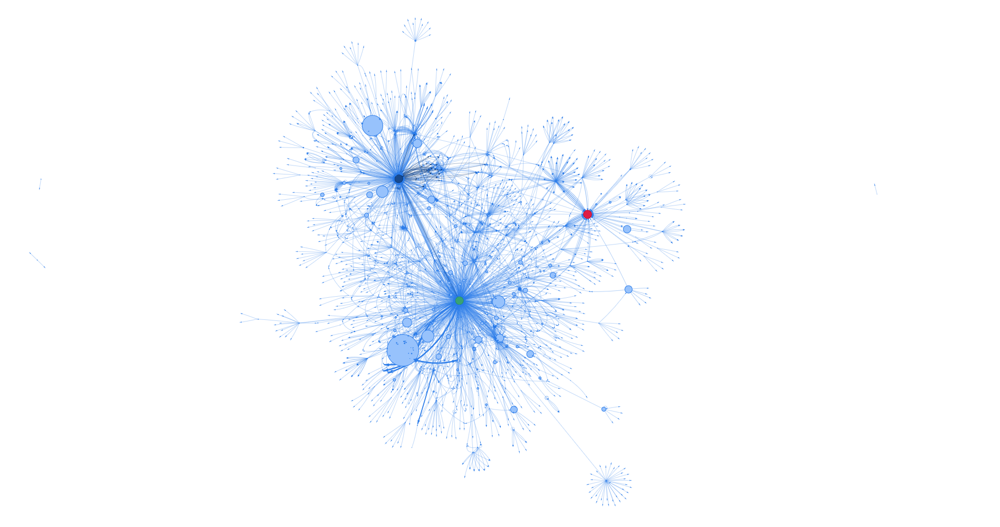

Here we see hat Nike has the most dense network and is mentioned from users with most followers, followed by Adidas and Lululemon.

### Network around Nike

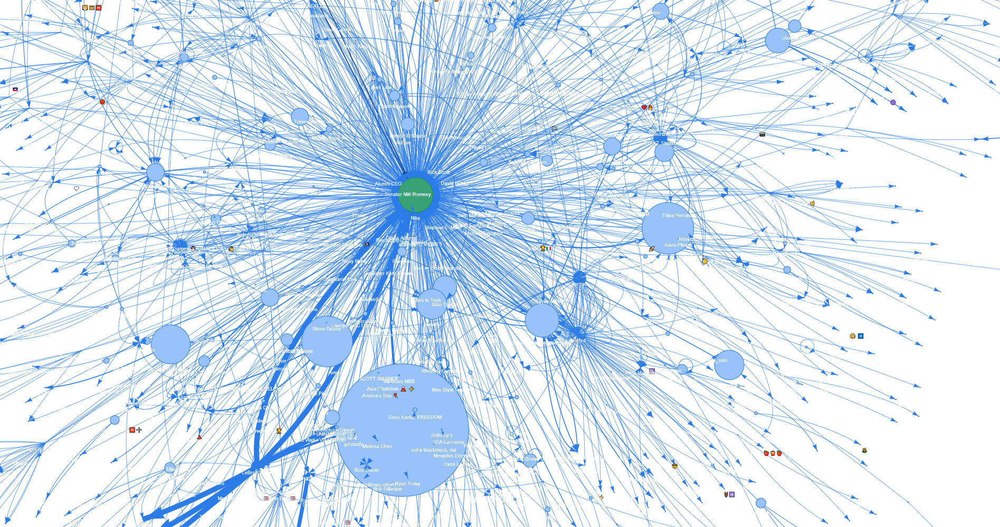

Nike is mentioned by users with a huge amount of followers. In the data proveded we see that NIke has only outgoing edges. So Nike is only mentioned from other users but itself not mentioning other users in own tweets.

Interrestingly we see that Nike receives some incomming edges from Adidas (dark blue arrows) but not the oposite.

Most influential users metion Nike are:
* Liverpool PC
* LeBron James
* Donald Trump Jr.
* TINA SNOW
* Taraji P. Henson
* Nike.com
* Roblox
* Nike Basketball
* Jake Tapper
* Marco Rubio
* Dallas Cowboys

### Network around Adidas

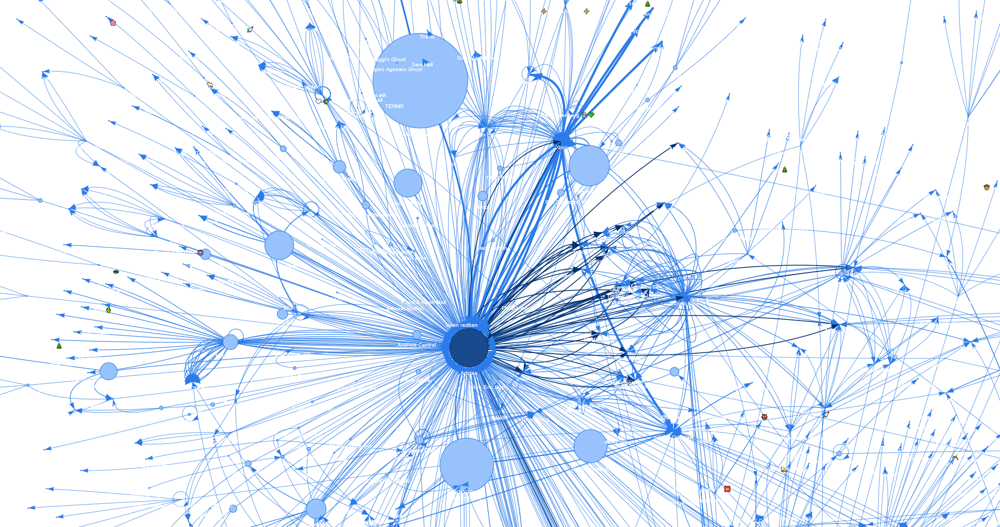

Adidas is the only of our tree brands that has some outgoing edges.

Most influential users metion Adidas are:
* Xbox
* Marcelotwelve
* Missy Elliot
* Dashie XP
* CoinMarketCap
* adidas Football
* QuavoYRN
* Complex
* Kat Graham
* Kendra Wilkinson

### Network around Lululemon

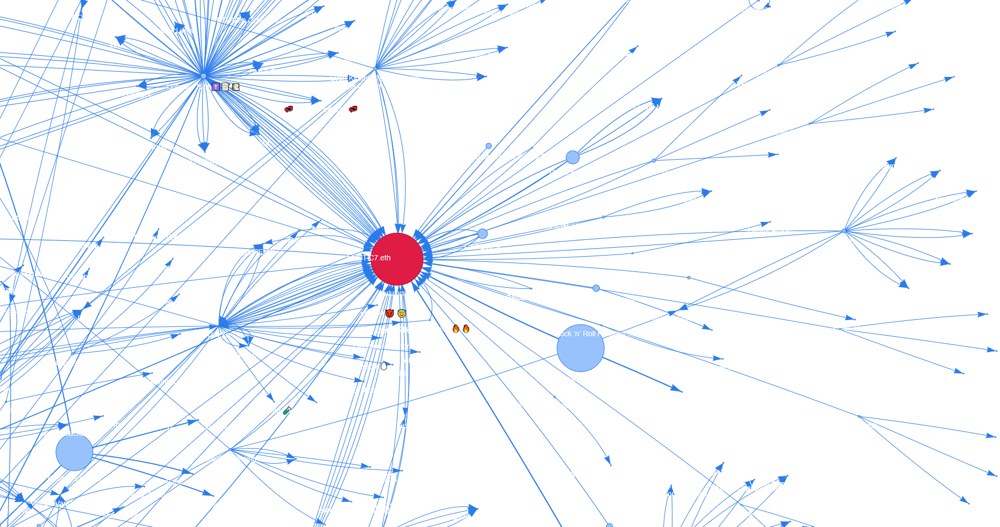

Lululemon has least number of mentions and is also mentioned by users with lesser followers. Also Lululemons has no outgoing edges.

Most influential users metion Adidas are:
* USA TODAY
* CNBC
* iJustine.eth
* DeeZe
* Leonard Kim
* Yahoo Finance
* Evan Kirstel #TechFluencer
* Jonah Lupton
* Oakley
* WFAA

##Who are the Most Important Bridgers?

Some users will mention multiple (or all three) brands. Who are those people? If bridge users (bridgers) exist, who are they? Why are they interested in this product so much? From an advertising/marketing perspective, these are people who are "pro users" of your category, and their hyper interest is something that you can use to engage with them, that is, they'll always be interested in your new product/services before others are.

In [169]:
users = {}
i = 0
for tweet in tweets:
  i += 1
  if i % 10000 == 0:
      print(f"Processed {i} tweets")
#  if not users[tweets[tweet]['user_id']] in users.keys():
  # users[tweets[tweet]['user_id']] = {}
  # users[tweets[tweet]['user_id']]['user_followers_count'] = tweets[tweet]['user_followers_count']
  for mention in tweets[tweet]['user_mentions']:
    # only add users that mention one of our brands
    if mention['id'] == 415859364 or \
     mention['id'] == 300114634 or \
     mention['id'] == 16252784:
      if not tweets[tweet]['user_id'] in users: 
        users[tweets[tweet]['user_id']] = {}
        users[tweets[tweet]['user_id']]['user_followers_count'] = tweets[tweet]['user_followers_count']
        users[tweets[tweet]['user_id']]['user_name'] = tweets[tweet]['user_name']
        users[tweets[tweet]['user_id']]["Nike"] = 0
        users[tweets[tweet]['user_id']]["Adidas"] = 0
        users[tweets[tweet]['user_id']]["Lululemon"] = 0
      if mention['id'] == 415859364:
        users[tweets[tweet]['user_id']]["Nike"] += 1
      if mention['id'] == 300114634:
        users[tweets[tweet]['user_id']]["Adidas"] += 1
      if mention['id'] == 16252784:
        users[tweets[tweet]['user_id']]["Lululemon"] += 1


Processed 10000 tweets
Processed 20000 tweets
Processed 30000 tweets
Processed 40000 tweets
Processed 50000 tweets
Processed 60000 tweets
Processed 70000 tweets
Processed 80000 tweets
Processed 90000 tweets
Processed 100000 tweets
Processed 110000 tweets
Processed 120000 tweets
Processed 130000 tweets
Processed 140000 tweets
Processed 150000 tweets
Processed 160000 tweets
Processed 170000 tweets


### Top 10 users with most followers mention at least one of our brands

In [170]:
for user in sorted(users, key=lambda x: (users[x]['user_followers_count']), reverse=True)[:10]:
  Nike = users[user]["Nike"]
  Adidas = users[user]["Adidas"]
  Lululemon = users[user]["Lululemon"]
  print(users[user]['user_name'], "with", users[user]['user_followers_count'], "followers","mentioned")
  print("Nike", Nike, "times")
  print("Adidas", Adidas, "times")
  print("Lululemon", Lululemon, "times")

LeBron James with 50614843 followers mentioned
Nike 2 times
Adidas 0 times
Lululemon 0 times
Liverpool FC with 18891253 followers mentioned
Nike 1 times
Adidas 0 times
Lululemon 0 times
Xbox with 17391389 followers mentioned
Nike 0 times
Adidas 6 times
Lululemon 0 times
Marcelotwelve with 12258139 followers mentioned
Nike 0 times
Adidas 1 times
Lululemon 0 times
TINA SNOW with 7352464 followers mentioned
Nike 1 times
Adidas 0 times
Lululemon 0 times
Donald Trump Jr. with 7232559 followers mentioned
Nike 3 times
Adidas 0 times
Lululemon 0 times
Missy Elliott with 6930157 followers mentioned
Nike 0 times
Adidas 1 times
Lululemon 0 times
Rolling Stone with 6338895 followers mentioned
Nike 1 times
Adidas 0 times
Lululemon 0 times
Taraji P. Henson with 5547550 followers mentioned
Nike 1 times
Adidas 0 times
Lululemon 0 times
DashieXP with 5232390 followers mentioned
Nike 0 times
Adidas 2 times
Lululemon 0 times


### Top 10 users mention Nike most often

In [171]:
for user in sorted(users, key=lambda x: (users[x]["Nike"]), reverse=True)[:10]:
  Nike = users[user]["Nike"]
  Adidas = users[user]["Adidas"]
  Lululemon = users[user]["Lululemon"]
  print(users[user]['user_name'], "with", users[user]['user_followers_count'], "followers","mentioned")
  print("Nike", Nike, "times")
  print("Adidas", Adidas, "times")
  print("Lululemon", Lululemon, "times")

#SneakerScouts with 18262 followers mentioned
Nike 6891 times
Adidas 0 times
Lululemon 0 times
HU's Bad Guys #HBOW with 57 followers mentioned
Nike 4067 times
Adidas 0 times
Lululemon 0 times
Kaya 👟🧋 with 1744 followers mentioned
Nike 720 times
Adidas 12 times
Lululemon 0 times
Jay KiCkZ with 986 followers mentioned
Nike 590 times
Adidas 13 times
Lululemon 0 times
(Girard Davout) 🤔☝️😁😘 with 698 followers mentioned
Nike 544 times
Adidas 0 times
Lululemon 0 times
Shock and Awe Ent. with 1330 followers mentioned
Nike 361 times
Adidas 0 times
Lululemon 0 times
VICKICKS👟 with 1060 followers mentioned
Nike 334 times
Adidas 11 times
Lululemon 0 times
Traci G with 2794 followers mentioned
Nike 321 times
Adidas 68 times
Lululemon 2 times
AMZ with 85 followers mentioned
Nike 291 times
Adidas 124 times
Lululemon 0 times
Shameless🤷‍♂️SNKRS Guy🌟OFFWht FanClub🙏🏼RIP VA with 539 followers mentioned
Nike 285 times
Adidas 0 times
Lululemon 0 times


### Top 10 users mention Adidas most often

In [172]:
for user in sorted(users, key=lambda x: (users[x]["Adidas"]), reverse=True)[:10]:
  Nike = users[user]["Nike"]
  Adidas = users[user]["Adidas"]
  Lululemon = users[user]["Lululemon"]
  print(users[user]['user_name'], "with", users[user]['user_followers_count'], "followers","mentioned")
  print("Nike", Nike, "times")
  print("Adidas", Adidas, "times")
  print("Lululemon", Lululemon, "times")

La Revelacion with 790 followers mentioned
Nike 137 times
Adidas 137 times
Lululemon 0 times
AMZ with 85 followers mentioned
Nike 291 times
Adidas 124 times
Lululemon 0 times
Le Prinzri 7 STAR with 717 followers mentioned
Nike 114 times
Adidas 110 times
Lululemon 0 times
Jajuan Michael Harley with 149 followers mentioned
Nike 89 times
Adidas 89 times
Lululemon 0 times
Mercito Gesta with 1111 followers mentioned
Nike 0 times
Adidas 68 times
Lululemon 0 times
Traci G with 2794 followers mentioned
Nike 321 times
Adidas 68 times
Lululemon 2 times
Ricardo Esteban Rovira Flores with 410 followers mentioned
Nike 0 times
Adidas 67 times
Lululemon 0 times
Kathrine Switzer with 9135 followers mentioned
Nike 0 times
Adidas 53 times
Lululemon 0 times
Amilee E Gross with 479 followers mentioned
Nike 0 times
Adidas 39 times
Lululemon 0 times
KRIMY with 74 followers mentioned
Nike 47 times
Adidas 35 times
Lululemon 0 times


### Top 10 users mention Lululemon most often

In [173]:
for user in sorted(users, key=lambda x: (users[x]["Lululemon"]), reverse=True)[:10]:
  Nike = users[user]["Nike"]
  Adidas = users[user]["Adidas"]
  Lululemon = users[user]["Lululemon"]
  print(users[user]['user_name'], "with", users[user]['user_followers_count'], "followers","mentioned")
  print("Nike", Nike, "times")
  print("Adidas", Adidas, "times")
  print("Lululemon", Lululemon, "times")

Jim Ace with 641 followers mentioned
Nike 0 times
Adidas 0 times
Lululemon 39 times
Matt Mulligan with 121 followers mentioned
Nike 0 times
Adidas 0 times
Lululemon 35 times
Andrew Ace with 136 followers mentioned
Nike 0 times
Adidas 0 times
Lululemon 31 times
Kinseyfit with 620 followers mentioned
Nike 0 times
Adidas 0 times
Lululemon 24 times
XC-skiing info with 1110 followers mentioned
Nike 3 times
Adidas 0 times
Lululemon 20 times
jacqui B with 12 followers mentioned
Nike 3 times
Adidas 0 times
Lululemon 20 times
jill Nauyokas with 239 followers mentioned
Nike 4 times
Adidas 0 times
Lululemon 16 times
chris with 20 followers mentioned
Nike 2 times
Adidas 0 times
Lululemon 16 times
Cyrus Kelly with 3045 followers mentioned
Nike 29 times
Adidas 0 times
Lululemon 14 times
DeeZe with 137687 followers mentioned
Nike 2 times
Adidas 1 times
Lululemon 14 times


### Top users with most followers that mention all of our brands

In [174]:
for user in sorted(users, key=lambda x: (users[x]['user_followers_count']), reverse=True)[:1000]:
#for user in users:
  if users[user]["Nike"] > 0 and users[user]["Adidas"] > 0 and users[user]["Lululemon"] > 0:
    Nike = users[user]["Nike"]
    Adidas = users[user]["Adidas"]
    Lululemon = users[user]["Lululemon"]
    print(users[user]['user_name'], "with", users[user]['user_followers_count'], "followers","mentioned")
    print("Nike", Nike, "times")
    print("Adidas", Adidas, "times")
    print("Lululemon", Lululemon, "times")

WWD with 2778642 followers mentioned
Nike 6 times
Adidas 1 times
Lululemon 1 times
Paul Lukas with 138246 followers mentioned
Nike 11 times
Adidas 3 times
Lululemon 1 times
DeeZe with 137687 followers mentioned
Nike 2 times
Adidas 1 times
Lululemon 14 times
WHOOP with 53358 followers mentioned
Nike 2 times
Adidas 2 times
Lululemon 1 times
MARKETING MAGAZINE with 47296 followers mentioned
Nike 9 times
Adidas 15 times
Lululemon 2 times


Se we see most users are focused on only one of our brands. Only a few users with lesser followers mention all brands. Top user who mention all brands is WWD whicch seems to be a US womens fashion magazine, Paul Lukas seems to be an US sports influencer, DeeZe also an influencer, WHOOP is a fitness tracker and MARKETING MAGAZINE a Canadian magazin about marketing. 

##Inspect Semantic Word Clusters

Look at the word clusters. Interpret them. Identify the key clusters of activity. What's going on in each cluster?

Lets first create a Word dictionarry and count the words. I take only words into account which are related to one of our brands. So at least one brand has to be mentioned.

I added some addional stopwords which are meaningless in my point of view.

In [179]:
word_counts = {}

stopwords = nltk.corpus.stopwords.words("english")
stopwords = stopwords + ['rt']
stopwords = stopwords + ["'s"]
stopwords = stopwords + ['…']
stopwords = stopwords + ['’']

i = 0
for tweet in tweets:
  i += 1
  relevant = False
  if i % 10000 == 0:
      print(f"Processed {i} tweets")
  # only tweets that mention one of our brands
  for mention in tweets[tweet]['user_mentions']:
    # only add users that mention one of our brands
    if mention['id'] == 415859364 or \
     mention['id'] == 300114634 or \
     mention['id'] == 16252784:
      relevant = True
  if relevant:
    text = tweets[tweet]['full_text']
    tokens = tokenize(text, tweet=True)
    tokens = remove_links(tokens)
    tokens = remove_stopwords(tokens, stopwords=stopwords)
    tokens = remove_punctuation(tokens, strip_mentions=True, strip_hashtags=True)
    tokens = lemmatize(tokens) 
    for word in tokens:
        if word not in word_counts:
            word_counts[word] = 0
        word_counts[word] += 1

Processed 10000 tweets
Processed 20000 tweets
Processed 30000 tweets
Processed 40000 tweets
Processed 50000 tweets
Processed 60000 tweets
Processed 70000 tweets
Processed 80000 tweets
Processed 90000 tweets
Processed 100000 tweets
Processed 110000 tweets
Processed 120000 tweets
Processed 130000 tweets
Processed 140000 tweets
Processed 150000 tweets
Processed 160000 tweets
Processed 170000 tweets


Create a list with all words sorted decending. So most common word will be on first position etc.

In [180]:
sorted_counts = sorted(word_counts.items(), key=lambda item: item[1], reverse=True)
sorted_words = [word for word, count in sorted_counts]

Check top commmon words

In [181]:
sorted_words[:10]

['nike',
 'adidas',
 'xbox',
 'sneakerscouts',
 'eneskanter',
 'day',
 'via',
 'available',
 'ad',
 'air']

## Create word graph with most common words

To keep the size of your semantic network managable, reduce the word set to just the top 1000 most popular words.

In [205]:
N = 1000
top_terms = sorted_words[:N]
#graph = nx.Graph()

# create undirected graph
words_g = net(height='1000px', width='100%', bgcolor='#222222', font_color='white', directed=False)

i = 0

# colour our brands different
# Nike
words_g.add_node(n_id = "Nike", title="Nike", label="Nike", size=50, color='#39a275', x= 100, y = 100, physics = False)
# Adidas
words_g.add_node(n_id = "Adidas", title="Adidas", label="Adidas", size=50, color='#194a8d', x= 1800, y = 100, physics = False)
# lululemon
words_g.add_node(n_id = "Lululemon", title="Lululemon", label="Lululemon", size=50, color='#df1c44', x= 950, y = 900, physics = False)

for tweet in tweets:
  i += 1
  nike = False
  adidas = False
  lululemon = False
  if i % 10000 == 0:
      print(f"Processed {i} tweets")
  # only tweets that mention one of our brands
  for mention in tweets[tweet]['user_mentions']:
    # only add users that mention one of our brands
    if mention['id'] == 415859364:
      nike = True
    if mention['id'] == 300114634:
      adidas = True
    if mention['id'] == 16252784:
      lululemon = True
  if nike or adidas or lululemon:
    text = tweets[tweet]['full_text']
    tokens = tokenize(text, tweet=True)
    tokens = remove_links(tokens)
    tokens = remove_stopwords(tokens, stopwords=stopwords)
    tokens = remove_punctuation(tokens, strip_mentions=True, strip_hashtags=True)
    tokens = lemmatize(tokens) 
    # reduce the tweet to terms in the 1000 word network and add the
    # term relationships to the graph
    nodes = [t for t in tokens if t in top_terms]
    for node in nodes:
      words_g.add_node(n_id = node, title=node, label=node)
      if nike:
        words_g.add_edge("Nike", node)
      if adidas:
        words_g.add_edge("Adidas", node)
      if lululemon:
        words_g.add_edge("Lululemon", node)

Processed 10000 tweets
Processed 20000 tweets
Processed 30000 tweets
Processed 40000 tweets
Processed 50000 tweets
Processed 60000 tweets
Processed 70000 tweets
Processed 80000 tweets
Processed 90000 tweets
Processed 100000 tweets
Processed 110000 tweets
Processed 120000 tweets
Processed 130000 tweets
Processed 140000 tweets
Processed 150000 tweets
Processed 160000 tweets
Processed 170000 tweets


In [206]:
words_g.show_buttons(filter_=['physics'])

In [207]:
words_g.save_graph('2_word_cluster.html')

Herer some screenshots of full word cluster and relevant parts for our questions.

For interactive html with physics check out the shared google drive folder


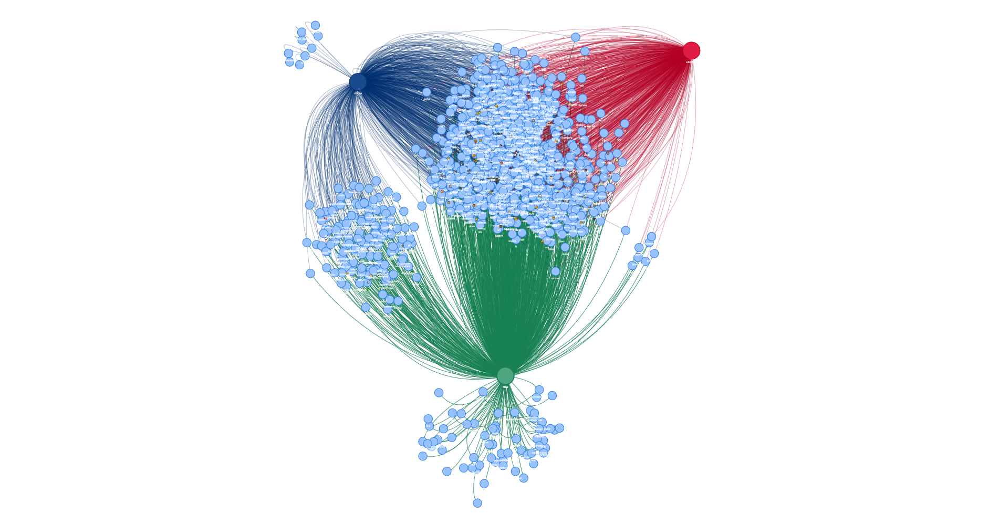

We see that most words are shared between all three brands, more common words are shared between Nike (green) and Adidas (blue) than with Lululemans (red).

Nike has the most uniqu terms followed by Adidas. Based on my filtering Lululemans has no uniqu words.



##What Word Clusters Does Each Brand Own?

What attributes (words, or cluster of words) does each brand uniquely own? That is, what attributes are uniquely linked to each brand? From a marketing perspective, the most central nodes are the attributes that each brand most "owns." These are implicit to the consumer, and therefore our strengths. Practically, this means that the brand doesn't need to do work advertising/marketing these perceptions, instead it should focus on reinforcing things that aren't as central, or missing from this semantic network completely.

### Nike

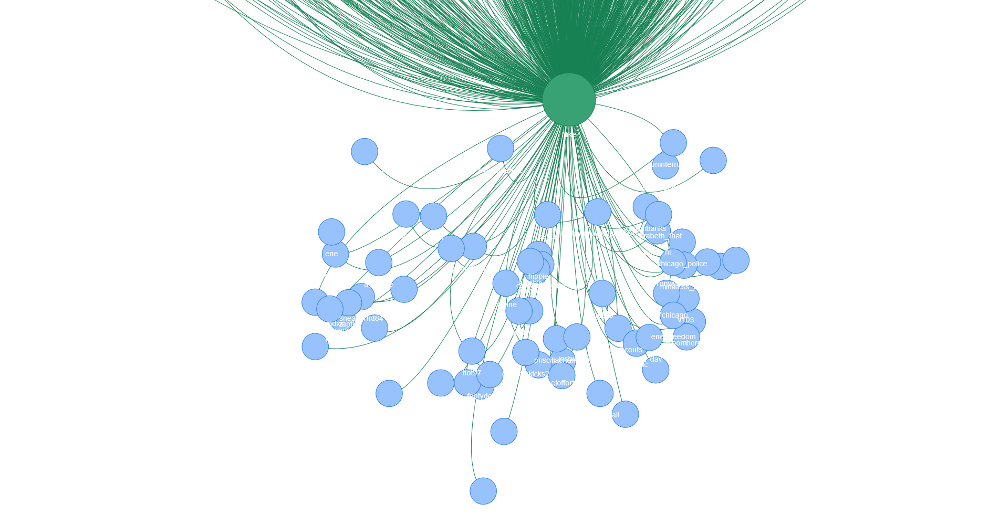

Nike own the most unique words.

Some of them are seems to be related with the british forces like
* britisharmy
* royalairforce
* royalnavy
* royalfamily

Some others are realted to othe rorganisations or brands like
* chicago_police
* disneystudios
* footydotcom_
* bloombergradio
* abc7chicago

and some rtealtzed to spcific types of sports
* unlvfootball
* nba_newyork

### Adidas

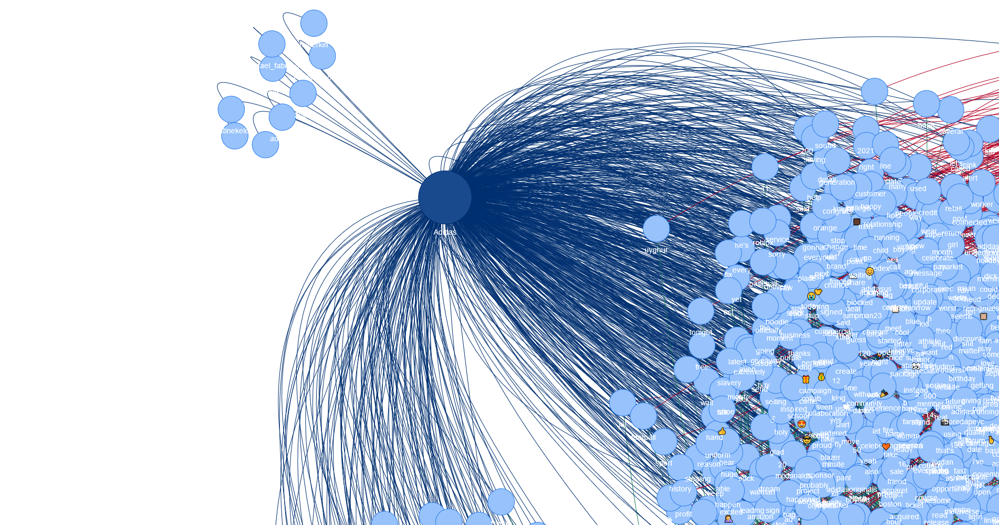

Adidas has lesser uniqu words compared to Nike and the words or clusters are harder to identify.

There are some words that probabnly belongs to people name like
* michael_fabiano
* austinekeler

Some other seems to be related to sports clubs
* lagalaxy
* maybes

and some propably belongs to products or marketing campains
* adizero
* hyperkin
* runningshoesgur

### Lululemon

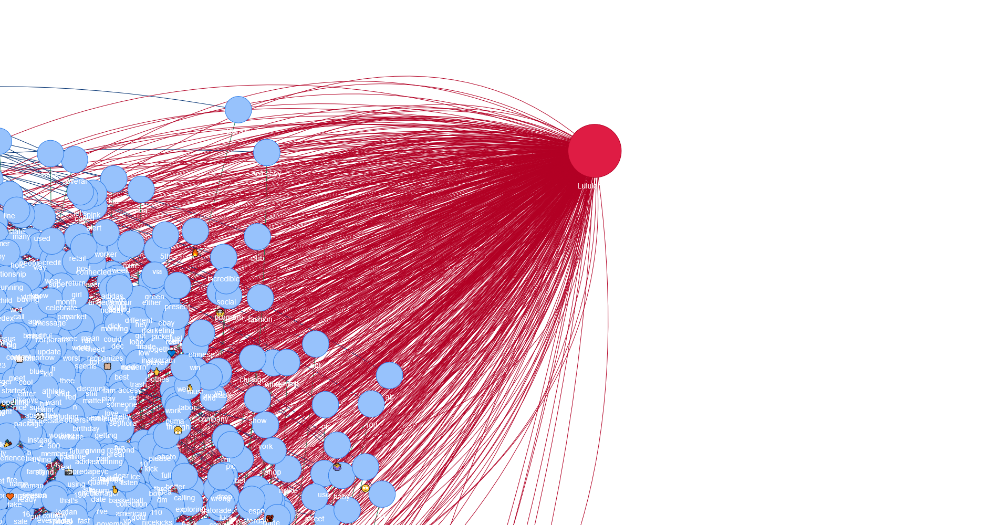

Releated to my filtering (stopwords, only top 1000 words) there are no unique words related to Lululemans.

##Look at Bridging Words

Brands will likely share some key attributes (words). If so, what are they? What commonalities do brands have with each other? These commonalities can be thought of as product differentiation things to avoid. That is, we'd never create advertising or marketing materials that reflect non-unique attributes about our products. Knowing that we share things with our competitors also can tell us how we better need to differentiate our products.

### Nike and Adidas

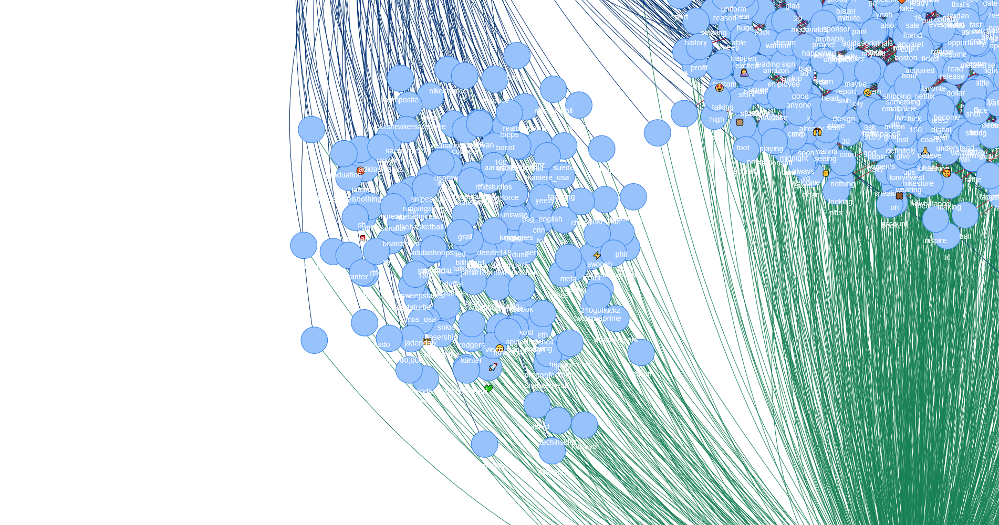

Between Nike and Adidas lot of words are shared.

There are some clusters related to sports and interestingly also to brand spcific sports that are shared
* easportsfifa
* jdsports
* nikeland
* nikesb
* nikefootball
* adidasfballus

So other seems to be ralted to people
* beyonce
* lebron
* eneskanter

and some to other brands or spcific topics
* japan
* pepsi
* graduation
* kicksonfire
* sneakerhead
* scctradingcards
* impossibleisnothing

### Lululemans and Nike

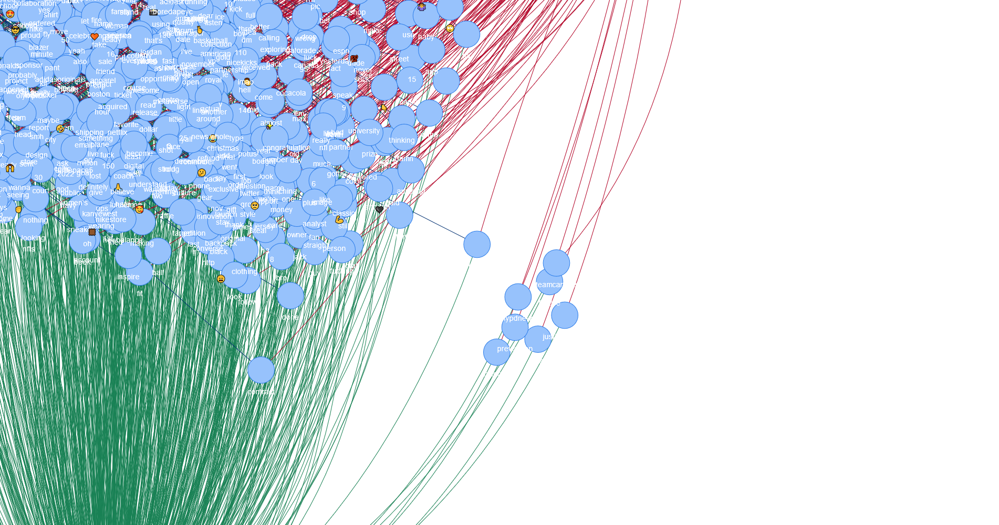

Only few words are shared between Lululemans and Nike.

Some are realted to Canda
* teamcanada
* justintrudeau

One releted to golf
* nikegolf

and some to specific use like
* prevention
* coal
* festive

### All brands

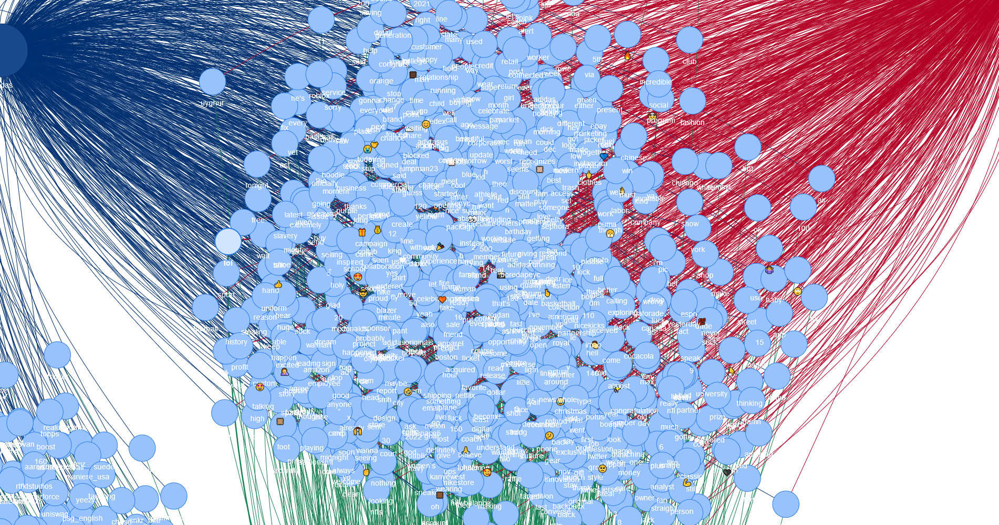

Shared between all brands are more general sports related words like
* sport
* football
* club
* nba
* baseball

Others are genral fashion and shopping related
* fashion
* shop
* shoes
* pretty
* dolar
* sold
* nice

and some are realted to the company itself
* company
* social
